# **1. Author**

**Student Name: Nikhil Jawade**

**Student ID: 210987533**

# **2. Problem Formulation**

With the use of MLEnd Hums and Whistles data, this machine learning pipeline that takes as an input a Potter or a StarWars audio segment and aims to predicts its song label.

# **3. Machine Learning Pipeline**

The Machine Learning Pipeline is represented as follows:

**Data Extraction --> Transformation --> Model --> Model Evaluation**

### **Data Extraction:**

**Input:** The '.wav' audio format inputs are taken from MLEnd Hums and Whistles dataset, totalling 834 combined samples for both Potter and StarWars each having 417 samples.

### **Transformation:**

***Feature Extraction:*** Extraction of different features such as power, pitch, mel-frequency cepstral coefficients, onset strength, spectral bandwidth from audio signal.

***Feature Selection:*** Selection of above mentioned features is carried out based on Standard (Pearson’s) Correlation Coefficient and dropping highly correlated features.

***Label Encoding:*** Converting Potter and StarWars categorical data to Boolean values (True and False).

***Linear Tranformation:*** Extracted features are then Normalized (MinMaxScaler) or Standardized (StandardScaler) (in some models).

### **Models:**

A support Vector Machine, Decision Tree Classification and a Stacking Classifier using LogisticRegression as the final estimator has been used as a model for prediction on the dataset.

**Output:** Transformed data is split and passed to the Machine Learning models for training and validation.

### **Model Evaluation:**

Model validation performance evaluated using accuracy, confusion matrix classification metrics (f-score, precision and recall).

# **4. Transformation Stage:**



The following was undertaken as a part of Transformation of Data:

***Feature Extraction and Selection:***

The input data is in '.wav' format. To reduce dimensionality, features are extracted using signal processing functions from the Librosa library. The following features were extracted:

*   Pitch Features(librosa.pyin()):
    1. Power (Squared Mean of Fundamental Frequency f0)

*   Spectral Features:
    2. Mel-frequency cepstral coefficients (MFCCs) (librosa.feature.mfcc)
    3. Spectral bandwidth (librosa.feature.spectral_bandwidth)
    4. Onset_strength (librosa.onset.onset_strength)

*   Beat and Tempo Feature
    5. Tempo Estimation (librosa.beat.tempo)

The features extracted results in a 2-D vector of input value and 5 features.

***Label Encoding:***

Potter and StarWars categorical data to Boolean values (Potter=True and StarWars=False) which outputs a 1D array.

***Linear Tranformation:***

The extracted features are then Normalized (MinMaxScaler) or Standardized (StandardScaler) (in some models).

Normalization (MinMaxScalar) scales each input variable separately to the range 0-1, which is the range for floating-point values where we have the most precision. Standardization scales each input variable separately by subtracting the mean (called centering) and dividing by the standard deviation to shift the distribution to have a mean of zero and a standard deviation of one. The selection of these methods is to preserve the shape of data and help ease the computations.

It returns a 2-D normalized vector of value and 5 features.

# **5. Modelling**

The following models are chosen to be implemented:



1.   Support Vector Machine (SVM) classification
2.   Decision Tree Classification
3.   Ensemble - Stacking Classifier - stack of estimators with a final classifier as LogisticRegression

# **6. Methodology**

The methodology behind how the data is trained, validated and assessed is described below:

***Data Split:***
The data is split using the sklearn's train_test_split() method. The split iss performed over as 70% training data and 30% validation data.

***Predictors and Labels:***
A 2-D vector of normalized features obtained from Transformation Stage are used as predictors and 'Potter', 'StarWars' are used as y-labels for the binary classification.

***Model Training:*** The models are trainined on the 70% of data ie training dataset. Support Vector Machine (SVM) classification, Decision Tree Classification and Ensemble - Stacking Classifier (LogisticRegression) algorithms were used.

***Model Peformance:*** The models are validated on the 20% data to assess its performance. Each model performance is then compared using a accuracy, confusion matrix classification metrics (f-score, precision and recall). Precision is the ratio of true positives to the sum of true and false positives while recall is the ratio of tru positives to the sum of true and false negatives. f-score is their mean.

# **7. Dataset**

As the data is a '.wav' audio file and the other information about the audio file can be extracted from its file name. Hence following procedures are followed in sequece  to pre-process the data and later fix the inconsistencies in its nomenclature to gain a metadata about the audio files.


In [ ]:
from google.colab import drive

import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
import os, sys, re, pickle, glob
import urllib.request
import zipfile
import IPython.display as ipd
from tqdm import tqdm
import librosa

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier, NeighborhoodComponentsAnalysis
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, StackingClassifier
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.pipeline import Pipeline
import seaborn as sns

drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### **Data-Preprocessing**

In [ ]:
def download_url(url, save_path):
  with urllib.request.urlopen(url) as dl_file:
    with open(save_path, 'wb') as out_file:
      out_file.write(dl_file.read())

def unzip_data(zip_path, directory):
  with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory)

### **Data download and storage**

The next step is to download all the zip files related to this task into the folder 'MyDrive/Data/MLEndHW'. 

Note: Create a folder '/content/drive/MyDrive/Data/MLEndHW/Task1/' in Google Drive.

In [ ]:
drive_loc = '/content/drive/MyDrive/Data/MLEndHW/Task1/'

#Following links have expired
urls = [{'name' : 'Potter_Part1', 'url' : 'https://collect.qmul.ac.uk/down?t=6P0I5CAE7JPPKNDU/4P729FD6DFNO8IT4NNFR458'},
        {'name' : 'StarWars_Part1', 'url' : 'https://collect.qmul.ac.uk/down?t=4HOGB7IH67J8QGL3/5D5TJMIP30DFVC69AQU5ETO'},
        {'name' : 'Potter_Part2', 'url' : 'https://collect.qmul.ac.uk/down?t=452THMOKUOST11V4/4L7IBFL5AJ3AMR45JVV9AC0'},
        {'name' : 'StarWars_Part2', 'url' : 'https://collect.qmul.ac.uk/down?t=4LUHB7IH67J8QGL3/6T5IF3SK8KQTL7FRD2113DO'}]

save_paths = []

for i in urls:
  save_paths.append(drive_loc + 'Task1/' + i['name'] + '.zip')

In [ ]:
for i in tqdm(range(len(urls))):
  temp_dict = urls[i]
  download_url(temp_dict['url'], save_paths[i])

Run the following cell to check that the Task1 folder contains the file 4 '.zip' files named:

In [ ]:
os.listdir(drive_loc)

The following cell will extract all 4 '.zip' files into the location defined in 'directory_to_extract_to'

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndHW/Task1/Data/'

for i in tqdm(save_paths):
  unzip_data(i, directory_to_extract_to)

Importing all the files in the path to a 'files' object. There are 834 audio files in the folder. 

In [ ]:
sample_path = '/content/drive/MyDrive/Data/MLEndHW/Task1/Data/*'
files = glob.glob(sample_path)
print(f'Total number of files : {len(files)}\n')

for _ in range(5):
  n = np.random.randint(834)
  display(ipd.Audio(files[n]))

Total number of files : 834


### **Creating Meta-data and Fixing inconsistencies:**

Creating a Data Frame to store the metadata that can be retrieved from the audio file names. With it, the inconsistencies in data and its recognition can be resolved.

In [ ]:
listofdict = []

for file in files:
  file_name = file.split('/')[-1]
  name_lower = file_name.lower()

  participant = file_name[name_lower.find('s'):file_name.find('_')]
  interpretation = 'NaN'
  song = 'NaN'
  if 'hum' in name_lower:
    interpretation = 'hum'
  elif 'whistle' or 'whi' in name_lower:
    interpretation = 'whistle'

  if 'potter' in name_lower:
    song = 'Potter'
  if 'harry' in name_lower:
    song = 'Potter'
  if 'star' in name_lower:
    song = 'StarWars'
  if 'war' in name_lower:
    song = 'StarWars'
  if 'imperial' in name_lower:
    song = 'StarWars'


  number = name_lower[name_lower.find('_'):]
  number = re.search(r'\d+', number).group()

  row = {
      'file_name': file_name,
      'participant': participant,
      'interpretation': interpretation,
      'number': number,
      'song': song,
  }

  listofdict.append(row)

task1_df = pd.DataFrame(listofdict).set_index('file_name')

task1_df

#task1_df[task1_df['song'] == 'Potter']

,participant,interpretation,number,song
file_name,,,,
S1_hum_2_Potter.wav,S1,hum,2,Potter
S1_whistle_2_Potter.wav,S1,whistle,2,Potter
S2_hum_2_Potter.wav,S2,hum,2,Potter
S2_whistle_2_Potter.wav,S2,whistle,2,Potter
S3_hum_1_Potter.wav,S3,hum,1,Potter
...,...,...,...,...
S219_hum_4_StarWars.wav,S219,hum,4,StarWars
S221_hum_1_StartWars.wav,S221,hum,1,StarWars
S221_hum_2_StarWars.wav,S221,hum,2,StarWars


### **Exploring Audio Data**

Plotting the amplitude against time gives the spectogram of an audio signal.

The amplitude pattern of Potter seems to differ than StarWars over time intervals and this could indetified as one of the feature.

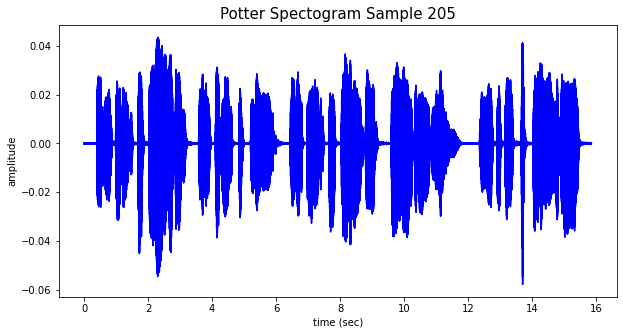

In [ ]:
n=random.randint(0, 209)
fs = None # Sampling frequency. If None, fs would be 22050
x, fs = librosa.load(files[n],sr=fs)
t = np.arange(len(x))/fs
plt.figure(figsize=(10, 5))
plt.title(f'Potter Spectogram Sample {n}',size=15)
plt.plot(t,x,c='blue')
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
display(ipd.Audio(files[n]))

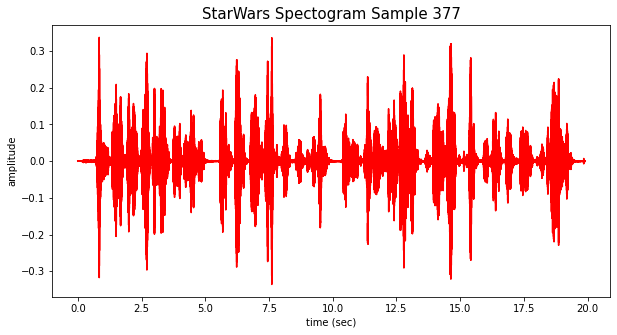

In [ ]:
n=random.randint(209, 419)
fs = None # Sampling frequency. If None, fs would be 22050
x, fs = librosa.load(files[n],sr=fs)
t = np.arange(len(x))/fs
plt.figure(figsize=(10, 5))
plt.title(f'StarWars Spectogram Sample {n}',size=15)
plt.plot(t,x,c='red')
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
display(ipd.Audio(files[n]))

In [ ]:
x, fs = librosa.load(files[n],sr=fs)
print('This audio signal has', len(x), 'samples')

This audio signal has 877467 samples


### **Feature Extraction:**

In [ ]:
def getPitch(x,fs,winLen=0.02):
  p = winLen*fs
  frame_length = int(2**int(p-1).bit_length())
  hop_length = frame_length//2
  f0, voiced_flag, voiced_probs = librosa.pyin(y=x, fmin=80, fmax=450, sr=fs,
                                                 frame_length=frame_length,hop_length=hop_length)
  return f0, voiced_flag

**Note:** Following feature extraction procedure takes around ~50-55 minutes, roughly ~3.5 sec per iteration for execution.

In [ ]:
#lists of features
feature_list = []

for file in tqdm(files):
    file_name = file.split('/')[-1]
    song = task1_df.loc[file_name]['song']

    fs = None # if None, fs would be 22050
    x, fs = librosa.load(file,sr=fs)
    mfcc = librosa.feature.mfcc(y=x, sr=fs)
    onset_env = librosa.onset.onset_strength(y=x, sr=fs)
    spec_bw = librosa.feature.spectral_bandwidth(y=x, sr=fs)
    tempo = librosa.beat.tempo(x, sr=fs)
    
    x = x/np.max(np.abs(x))
    f0, voiced_flag = getPitch(x,fs,winLen=0.02)
    power = np.sum(x**2)/len(x)
    #voiced_fr = np.mean(voiced_flag)

    row = {
        'song': song,
        'mfcc': np.mean(mfcc),
        'onset_env': np.mean(onset_env),
        'spec_bw': np.mean(spec_bw),
        'tempo ': np.mean(tempo),
        'power': power,
        #'voiced_fr': voiced_fr
        }
    
    feature_list.append(row)

feature_df = pd.DataFrame(feature_list)

feature_df

100%|██████████| 834/834 [50:45<00:00,  3.65s/it]


,song,mfcc,onset_env,spec_bw,tempo,power
0,Potter,-17.621126,1.273176,5142.033510,172.265625,0.001961
1,Potter,-21.501249,1.363420,5266.609683,120.185320,0.020419
2,Potter,-21.670408,1.160315,4765.788845,139.674831,0.053579
3,Potter,-26.031940,1.305380,5767.036432,120.185320,0.037227
4,Potter,-11.944511,0.966993,1981.262522,123.046875,0.093276
...,...,...,...,...,...,...
829,StarWars,-22.566328,1.218404,1726.818536,107.666016,0.023949
830,StarWars,-22.310841,1.247406,2891.146104,101.332721,0.028499
831,StarWars,-20.766644,1.130851,3148.085497,99.384014,0.050066
832,StarWars,-30.624329,0.922024,4053.917060,126.048018,0.001234


### **Feature Selection:**

The following Correlation Coefficients (Pearson's) demonstrate that there is not a strong correlation between features, which means none will be removed. This is also shown in the heatmap below.

In [ ]:
print("\nCorrelation coefficients:")
corr=feature_df.corr()
corr


Correlation coefficients:


,mfcc,onset_env,spec_bw,tempo,power
mfcc,1.000000,0.314125,-0.193054,-0.078023,0.255256
onset_env,0.314125,1.000000,0.053865,-0.193298,0.188346
spec_bw,-0.193054,0.053865,1.000000,0.059453,-0.160273
tempo,-0.078023,-0.193298,0.059453,1.000000,-0.006831
power,0.255256,0.188346,-0.160273,-0.006831,1.000000


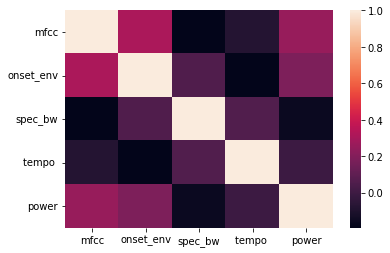

In [ ]:
sns.heatmap(corr)

### **Preparing the Predictors and Labels:**

The features extracted results in a 2-D vector of input value and 5 features. A 1-D vector of labels is also obtained where True corresponds to Potter and False to StarWars

In [ ]:
X=np.array(feature_df.iloc[:,1:7])

y=np.array(feature_df['song']=='Potter')

X.shape, y.shape

((834, 5), (834,))

# **8. Results:**

With Pipeline function in sklearn, it gets easier to create one sequence of code and execute them in sequence containing ML algortihm. So, in this execution there are 3 Pipelines that are created to execute the data over 3 different algorithms and generate 3 different models.

Support Vector Machine - **pipe1**

Decision Tree Classifier - **pipe2**

Stacking Classifier with Logistic Regression - **pipe3**

### **Spliting the Data:**

The data is divided as 70% training and 30% validation.

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X,y,test_size=0.3)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((583, 5), (251, 5), (583,), (251,))

## **Model 1: Support Vector Machine Classifier**

In [ ]:
pipe1 = Pipeline([('scaler', MinMaxScaler()), ('svc', SVC(C=1, gamma=2))])

pipe1.fit(X_train, y_train)

print('Support Vector Machine Results: \n')
print(f'Training Accuracy:\t {pipe1.score(X_train, y_train)}')
print(f'Validation Accuracy:\t {pipe1.score(X_val, y_val)}')

#count_arr = np.bincount(y_val)
#print(count_arr[0])

Support Vector Machine Results: 

Training Accuracy:	 0.7753001715265866
Validation Accuracy:	 0.7848605577689243


In [ ]:
y_preds_svc=list(pipe1.predict(X_val))

print(classification_report(y_val, y_preds_svc,target_names=['StarWars','Potter']))
train_accuracy=accuracy_score(y_val, y_preds_svc)

              precision    recall  f1-score   support

    StarWars       0.83      0.71      0.77       125
      Potter       0.75      0.86      0.80       126

    accuracy                           0.78       251
   macro avg       0.79      0.78      0.78       251
weighted avg       0.79      0.78      0.78       251



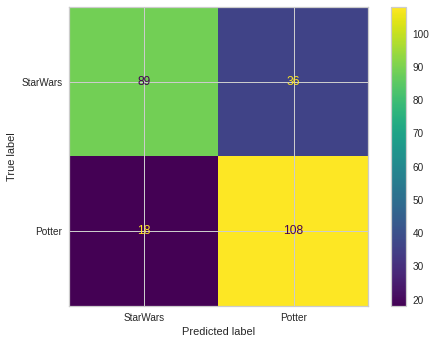

In [ ]:
cm_svc=confusion_matrix(y_val, y_preds_svc)

cmd_obj_svc=ConfusionMatrixDisplay(cm_svc,display_labels=['StarWars','Potter'])
cmd_obj_svc.plot()

## **Model 2: Decision Tree Classifier**

In [ ]:
pipe2 = Pipeline([('scaler', StandardScaler()), ('dtc', DecisionTreeClassifier(max_depth=5))])
pipe2.fit(X_train, y_train)

print('Support Vector Machine Results: \n')
print(f'Training Accuracy:\t {pipe2.score(X_train, y_train)}')
print(f'Validation Accuracy:\t {pipe2.score(X_val, y_val)}')

Support Vector Machine Results: 

Training Accuracy:	 0.8130360205831904
Validation Accuracy:	 0.7171314741035857


In [ ]:
y_preds_dtc=list(pipe2.predict(X_val))

print(classification_report(y_val, y_preds_dtc,target_names=['StarWars','Potter']))
train_accuracy=accuracy_score(y_val, y_preds_dtc)

              precision    recall  f1-score   support

    StarWars       0.79      0.58      0.67       125
      Potter       0.67      0.85      0.75       126

    accuracy                           0.72       251
   macro avg       0.73      0.72      0.71       251
weighted avg       0.73      0.72      0.71       251



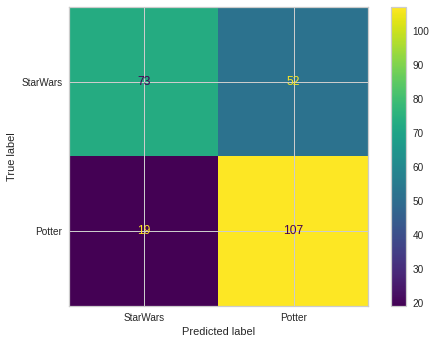

In [ ]:
cm_dtc=confusion_matrix(y_val, y_preds_dtc)

cmd_obj_dtc=ConfusionMatrixDisplay(cm_dtc,display_labels=['StarWars','Potter'])
cmd_obj_dtc.plot()

## **Model 3: Stacking Classifier**

In [ ]:
estimators = [
('svc', pipe1),
('dtc', pipe2)
]

pipe3 = Pipeline([('scaler', StandardScaler()), ('stacking', StackingClassifier(estimators=estimators,final_estimator=LogisticRegression()))])

pipe3.fit(X_train, y_train)

print(f'Training Accuracy:{pipe3.score(X_train, y_train)}')
print(f'Validation Accuracy {pipe3.score(X_val, y_val)}')

Training Accuracy:0.8061749571183533
Validation Accuracy 0.7729083665338645


In [ ]:
y_preds_final=list(pipe3.predict(X_val))
print(classification_report(y_val, y_preds_final,target_names=['StarWars','Potter']))
train_accuracy=accuracy_score(y_val, y_preds_final)

              precision    recall  f1-score   support

    StarWars       0.82      0.70      0.75       125
      Potter       0.74      0.85      0.79       126

    accuracy                           0.77       251
   macro avg       0.78      0.77      0.77       251
weighted avg       0.78      0.77      0.77       251



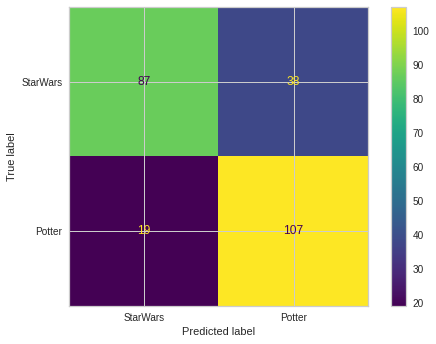

In [ ]:
cm_final = confusion_matrix(y_val, y_preds_final)
cmd_obj_final = ConfusionMatrixDisplay(cm_final,display_labels=['StarWars','Potter'])
cmd_obj_final.plot()

# **9. Conclusion**

### **Model Evaluation:**

The accuracy returned by all 3 models/pipelines was somewhat similar. However, Stacking Classifier performed well when it comes to training as well validation accuracy.

### **Sugested Improvements:**

**Feature Extraction:** More siignal processing features could be explored and extracted to possibilty improve classification perfomance based on specific problem.

**Class Balance**: Even though a balanced model was found, the data classes were relatively imbalanced. Hum files were significantly more than Whistle files. Balanced intepretation files would help improve performance.